<p style="align: center;"><img align=center src="https://drive.google.com/uc?export=view&id=1I8kDikouqpH4hf7JBiSYAeNT2IO52T-T" width=600 height=480/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Generative adversarial networks</b></h3>



В этом домашнем задании вы обучите GAN генерировать лица людей и посмотрите на то, как можно оценивать качество генерации

In [44]:
import os
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torch
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
from torchvision.utils import save_image
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.set(style='darkgrid', font_scale=1.2)
DEVICE = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')


## Часть 1. Подготовка данных (1 балл)

В качестве обучающей выборки возьмем часть датасета [Flickr Faces](https://github.com/NVlabs/ffhq-dataset), который содержит изображения лиц людей в высоком разрешении (1024х1024). Оригинальный датасет очень большой, поэтому мы возьмем его часть. Скачать датасет можно [здесь](https://www.kaggle.com/datasets/tommykamaz/faces-dataset-small?resource=download-directory) и  [здесь](https://drive.google.com/drive/folders/14H7LQWzd09SaM11oLfGtd455sWH2rmRW?usp=share_link)

Давайте загрузим наши изображения. Напишите функцию, которая строит DataLoader для изображений, при этом меняя их размер до нужного значения (размер 1024 слишком большой, поэтому мы рекомендуем взять размер 128 либо немного больше)

In [45]:
!rm -r ~/.kaggle
!mkdir ~/.kaggle
!mv ./kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download -d tommykamaz/faces-dataset-small

!mkdir Dataset
!unzip -q /content/faces-dataset-small.zip -d /content/Dataset
!rm /content/faces-dataset-small.zip

mv: cannot stat './kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory
Traceback (most recent call last):
  File "/opt/conda/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/opt/conda/lib/python3.10/site-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/opt/conda/lib/python3.10/site-packages/kaggle/api/kaggle_api_extended.py", line 403, in authenticate
    raise IOError('Could not find {}. Make sure it\'s located in'
OSError: Could not find kaggle.json. Make sure it's located in /root/.kaggle. Or use the environment method.
mkdir: cannot create directory 'Dataset': File exists
unzip:  cannot find or open /content/faces-dataset-small.zip, /content/faces-dataset-small.zip.zip or /content/faces-dataset-small.zip.ZIP.
rm: cannot remove '/content/faces-dataset-small.zip': No such file or directory


In [46]:
def get_dataloader(image_size, batch_size):
  """
  Builds dataloader for training data.
  Use tt.Compose and tt.Resize for transformations
  :param image_size: height and wdith of the image
  :param batch_size: batch_size of the dataloader
  :returns: DataLoader object
  """
  # TODO: resize images, convert them to tensors and build dataloader
  train_ds = ImageFolder("/kaggle/input/faces-dataset-small", transform=tt.Compose([
    tt.Resize(image_size),
    tt.CenterCrop(image_size),
    tt.ToTensor(),
    tt.Normalize(mean=(0.5,0.5,0.5), std=(0.5,0.5,0.5))]))

  return DataLoader(train_ds, batch_size, shuffle=True, num_workers=2, pin_memory=True)

In [47]:
image_size = 128
batch_size = 32
train_loader = get_dataloader(image_size, batch_size)

## Часть 2. Построение и обучение модели (2 балла)

Сконструируйте генератор и дискриминатор. Помните, что:
* дискриминатор принимает на вход изображение (тензор размера `3 x image_size x image_size`) и выдает вероятность того, что изображение настоящее (тензор размера 1)

* генератор принимает на вход тензор шумов размера `latent_size x 1 x 1` и генерирует изображение размера `3 x image_size x image_size`

In [48]:
discriminator = nn.Sequential(
    # in: 3 x 128 x 128

    nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(32),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 32 x 64 x 64

    nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1
    nn.Flatten(),
    nn.Sigmoid())

In [49]:
latent_size = 128

generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(32),
    nn.ReLU(True),
    # out: 32 x 64 x 64

    nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 128 x 128
)

Перейдем теперь к обучению нашего GANа. Алгоритм обучения следующий:
1. Учим дискриминатор:
  * берем реальные изображения и присваиваем им метку 1
  * генерируем изображения генератором и присваиваем им метку 0
  * обучаем классификатор на два класса

2. Учим генератор:
  * генерируем изображения генератором и присваиваем им метку 0
  * предсказываем дискриминаторором, реальное это изображение или нет


В качестве функции потерь берем бинарную кросс-энтропию

In [50]:
lr = 0.0002

model = {
    "discriminator": discriminator.to(DEVICE),
    "generator": generator.to(DEVICE)
}

criterion = {
    "discriminator": nn.BCELoss(),
    "generator": nn.BCELoss()
}

In [51]:
def denorm(img_tensors):
    return img_tensors * 0.5 + 0.5

def show_images(images, nmax=128):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))
    plt.pause(0.3)
    plt.show()

def fit(model, criterion, epochs, lr):
  # TODO: build optimizers and train your GAN
  model['discriminator'].train()
  model['generator'].train()
  torch.cuda.empty_cache()

  losses_g = []
  losses_d = []
  real_scores = []
  fake_scores = []

  optimizer = {
        "discriminator": torch.optim.Adam(model["discriminator"].parameters(),
                                          lr=lr, betas=(0.5, 0.999)),
        "generator": torch.optim.Adam(model["generator"].parameters(),
                                      lr=lr, betas=(0.5, 0.999))
    }

  for epoch in range(epochs):
        loss_d_per_epoch = []
        loss_g_per_epoch = []
        real_score_per_epoch = []
        fake_score_per_epoch = []

        for real_images, _ in tqdm(train_loader):

            # train discriminator
            optimizer['discriminator'].zero_grad()

            real_preds = model['discriminator'](real_images.to(DEVICE))
            real_targets = torch.ones(real_images.size(0), 1, device = DEVICE)
            real_loss = criterion['discriminator'](real_preds, real_targets)
            cur_real_score = torch.mean(real_preds).item()

            # generate fake images
            latent = torch.randn(batch_size, latent_size, 1, 1, device = DEVICE)
            fake_images = model['generator'](latent)

            fake_targets = torch.zeros(fake_images.size(0), 1, device = DEVICE)
            fake_preds = model['discriminator'](fake_images)
            fake_loss = criterion['discriminator'](fake_preds, fake_targets)
            cur_fake_score = torch.mean(fake_preds).item()

            real_score_per_epoch.append(cur_real_score)
            fake_score_per_epoch.append(cur_fake_score)

            # Update discriminator weights
            loss_d = real_loss + fake_loss
            loss_d.backward()
            optimizer["discriminator"].step()
            loss_d_per_epoch.append(loss_d.item())

            # Train generator
            optimizer["generator"].zero_grad()

            # Generate fake images
            latent = torch.randn(batch_size, latent_size, 1, 1, device = DEVICE)
            fake_images = model["generator"](latent)

            preds = model["discriminator"](fake_images)
            targets = torch.ones(batch_size, 1, device=DEVICE)
            loss_g = criterion["generator"](preds, targets)

            # Update generator weights
            loss_g.backward()
            optimizer["generator"].step()
            loss_g_per_epoch.append(loss_g.item())

        # Record losses & scores
        losses_g.append(np.mean(loss_g_per_epoch))
        losses_d.append(np.mean(loss_d_per_epoch))
        real_scores.append(np.mean(real_score_per_epoch))
        fake_scores.append(np.mean(fake_score_per_epoch))

        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs,
            losses_g[-1], losses_d[-1], real_scores[-1], fake_scores[-1]))

        xb = torch.randn(batch_size, latent_size, 1, 1, device=DEVICE)
        generate_fake_images = generator(xb)
        show_images(generate_fake_images.cpu())

  return losses_g, losses_d, real_scores, fake_scores

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [1/50], loss_g: 10.9617, loss_d: 0.4397, real_score: 0.9090, fake_score: 0.1229


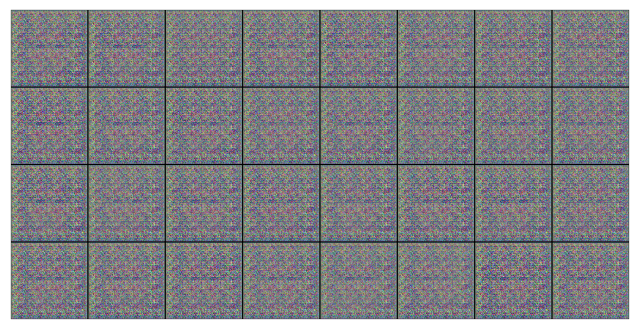

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [2/50], loss_g: 7.5855, loss_d: 0.3365, real_score: 0.9015, fake_score: 0.1162


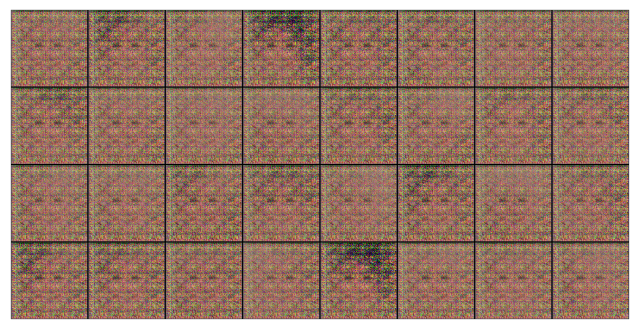

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [3/50], loss_g: 7.9195, loss_d: 0.0980, real_score: 0.9549, fake_score: 0.0414


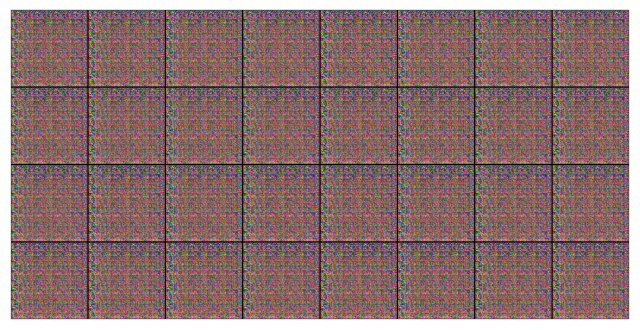

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [4/50], loss_g: 7.2144, loss_d: 0.0286, real_score: 0.9854, fake_score: 0.0126


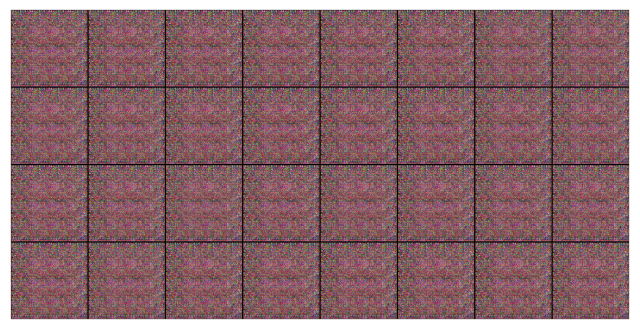

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [5/50], loss_g: 6.8035, loss_d: 0.4985, real_score: 0.9407, fake_score: 0.0375


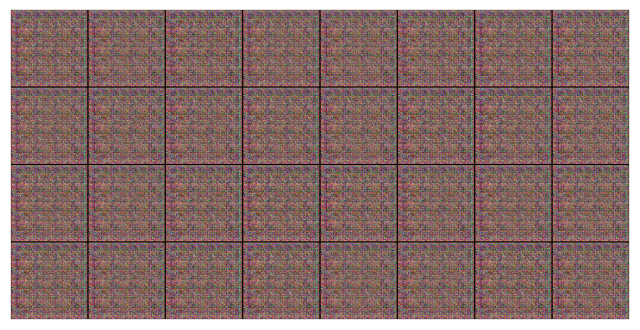

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [6/50], loss_g: 6.2825, loss_d: 0.0231, real_score: 0.9895, fake_score: 0.0122


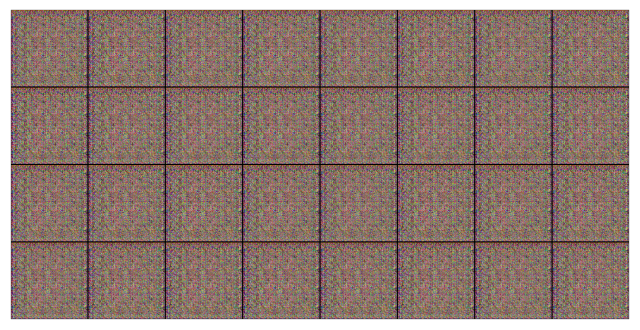

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [7/50], loss_g: 6.4292, loss_d: 0.0099, real_score: 0.9950, fake_score: 0.0048


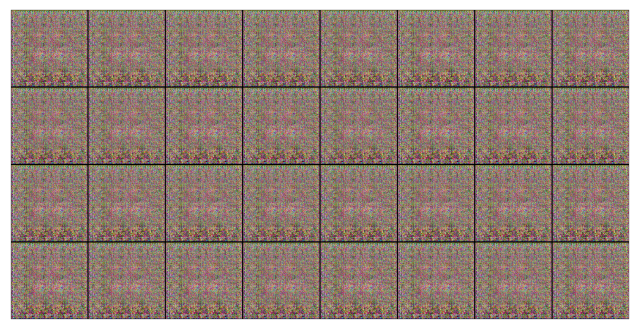

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [8/50], loss_g: 7.7944, loss_d: 0.3970, real_score: 0.9464, fake_score: 0.0326


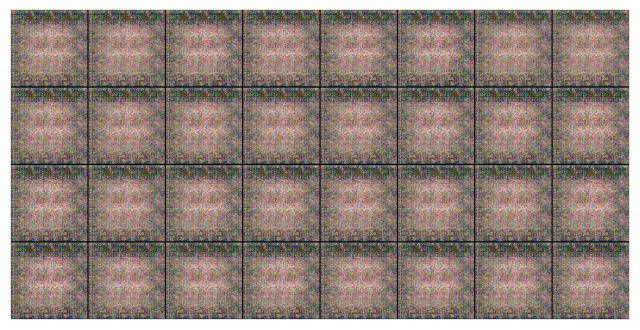

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [9/50], loss_g: 5.8794, loss_d: 0.0634, real_score: 0.9700, fake_score: 0.0266


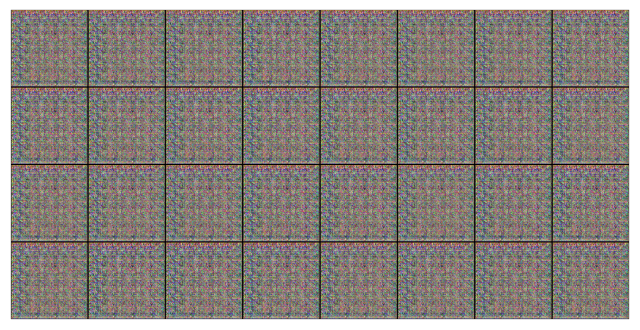

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [10/50], loss_g: 5.9277, loss_d: 0.0179, real_score: 0.9911, fake_score: 0.0087


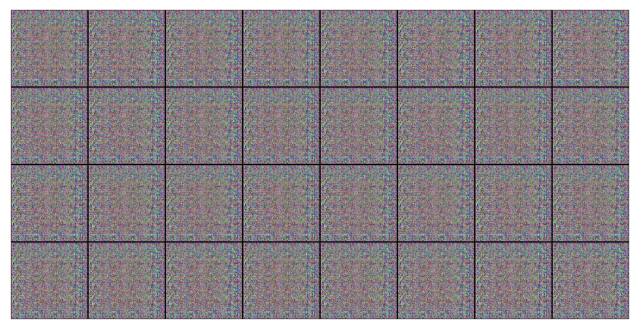

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [11/50], loss_g: 6.2904, loss_d: 0.0081, real_score: 0.9963, fake_score: 0.0043


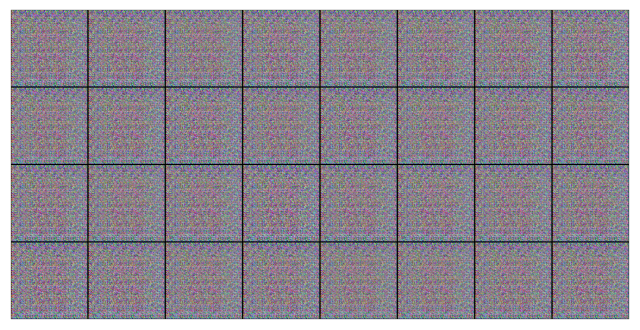

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [12/50], loss_g: 6.8292, loss_d: 0.0075, real_score: 0.9964, fake_score: 0.0031


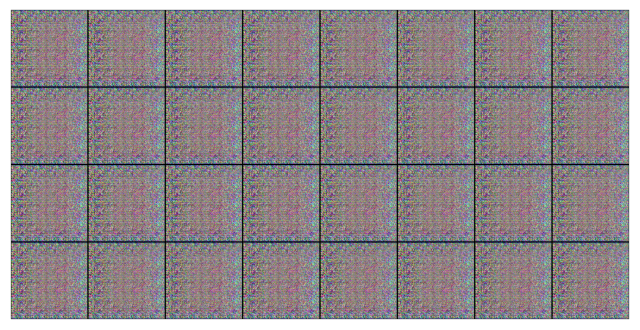

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [13/50], loss_g: 5.7879, loss_d: 0.3746, real_score: 0.9425, fake_score: 0.0406


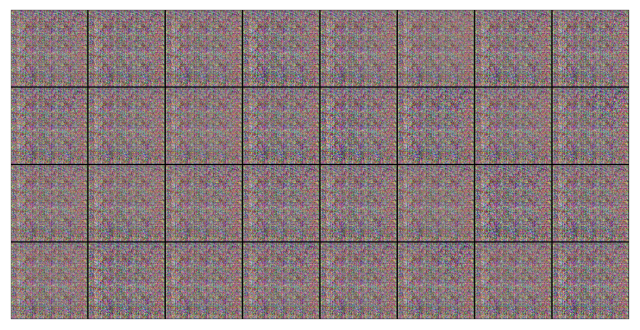

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [14/50], loss_g: 5.5890, loss_d: 0.0188, real_score: 0.9912, fake_score: 0.0097


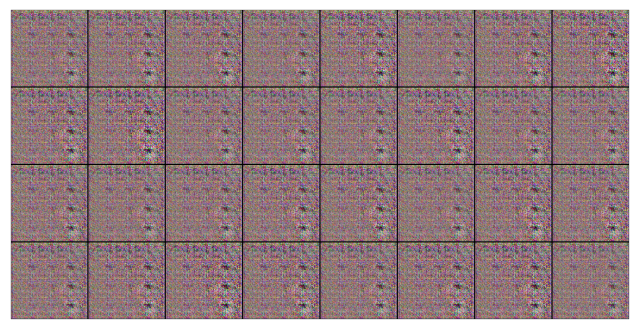

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [15/50], loss_g: 6.1523, loss_d: 0.0090, real_score: 0.9955, fake_score: 0.0044


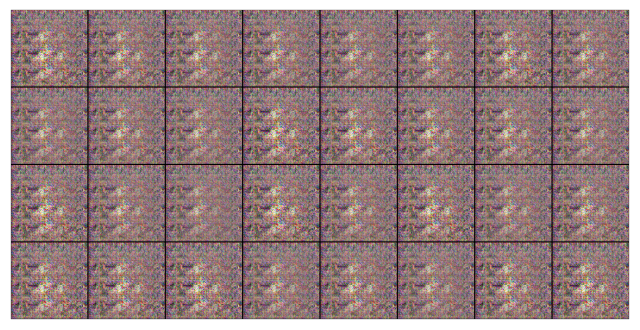

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [16/50], loss_g: 6.3222, loss_d: 0.1412, real_score: 0.9630, fake_score: 0.0349


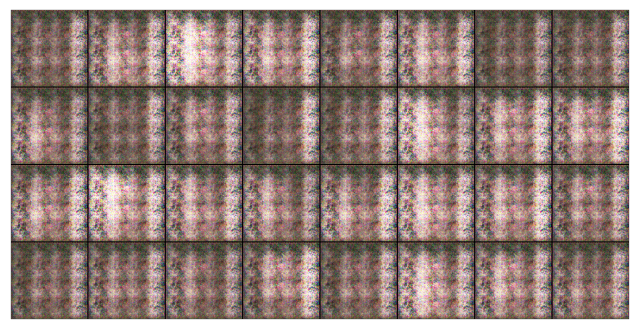

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [17/50], loss_g: 4.1566, loss_d: 0.5149, real_score: 0.8509, fake_score: 0.1544


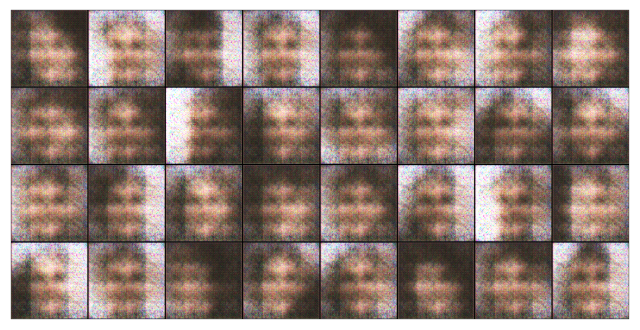

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [18/50], loss_g: 5.2337, loss_d: 0.4630, real_score: 0.8783, fake_score: 0.1212


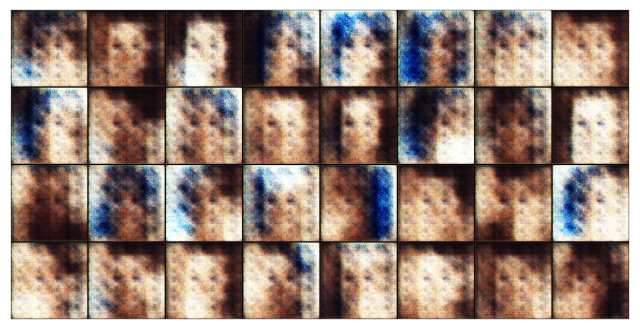

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [19/50], loss_g: 4.4150, loss_d: 0.5869, real_score: 0.8636, fake_score: 0.1369


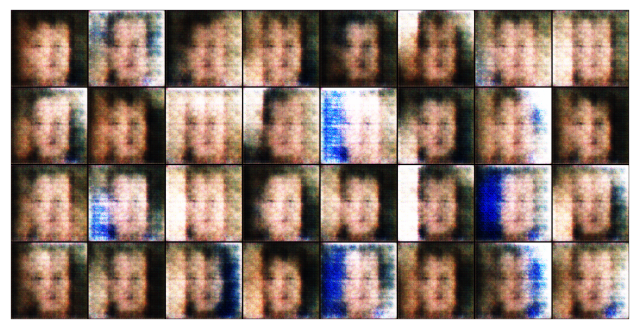

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [20/50], loss_g: 4.2053, loss_d: 0.4673, real_score: 0.8597, fake_score: 0.1406


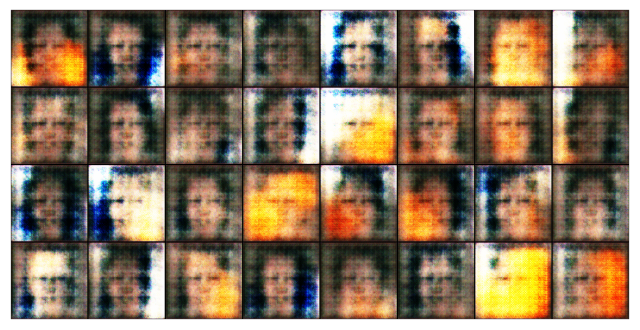

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [21/50], loss_g: 4.8737, loss_d: 0.5495, real_score: 0.8527, fake_score: 0.1501


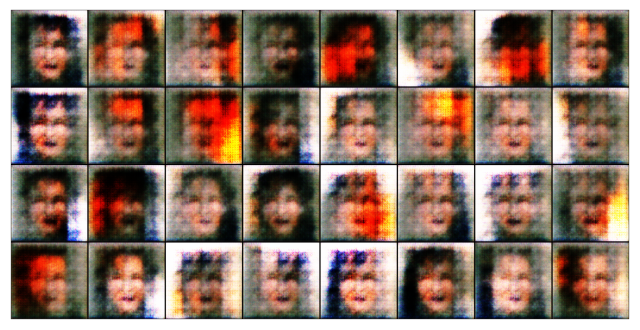

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [22/50], loss_g: 4.9650, loss_d: 0.4132, real_score: 0.8718, fake_score: 0.1251


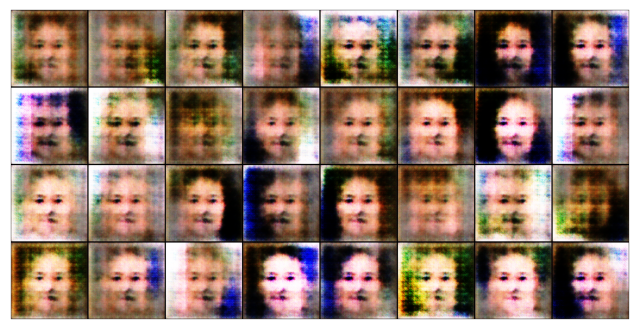

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [23/50], loss_g: 4.6168, loss_d: 0.5872, real_score: 0.8412, fake_score: 0.1640


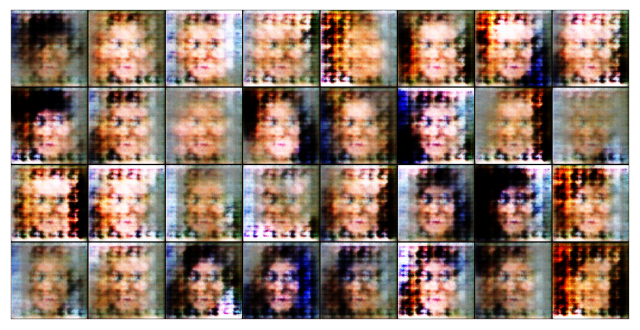

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [24/50], loss_g: 4.7274, loss_d: 0.6493, real_score: 0.8294, fake_score: 0.1642


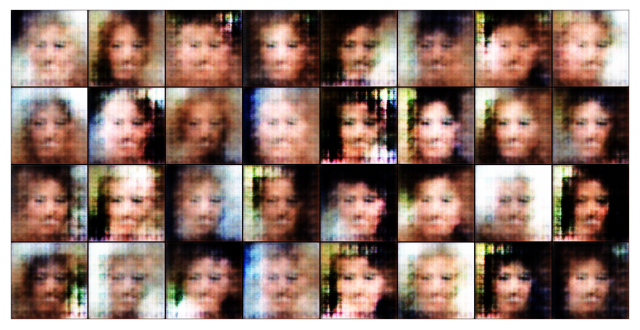

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [25/50], loss_g: 3.9393, loss_d: 0.5944, real_score: 0.8246, fake_score: 0.1827


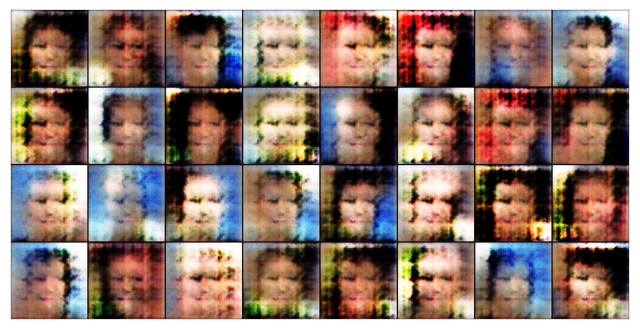

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [26/50], loss_g: 4.3311, loss_d: 0.5358, real_score: 0.8269, fake_score: 0.1720


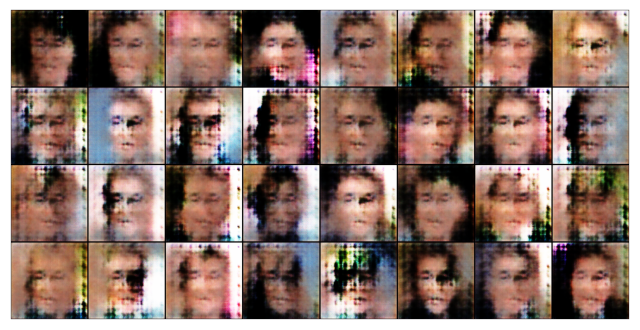

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [27/50], loss_g: 4.4742, loss_d: 0.6082, real_score: 0.8095, fake_score: 0.1891


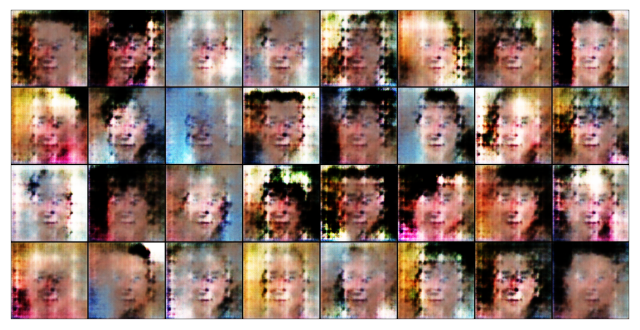

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [28/50], loss_g: 4.7988, loss_d: 0.5764, real_score: 0.8249, fake_score: 0.1820


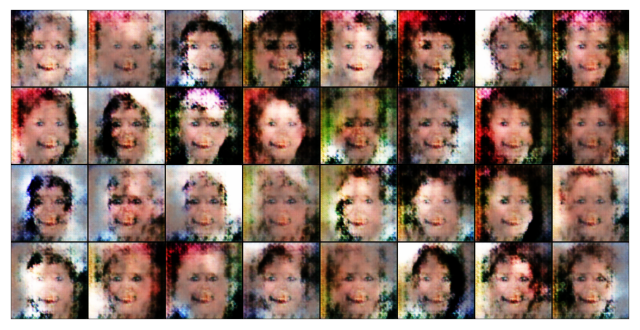

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [29/50], loss_g: 4.6650, loss_d: 0.6244, real_score: 0.8068, fake_score: 0.1819


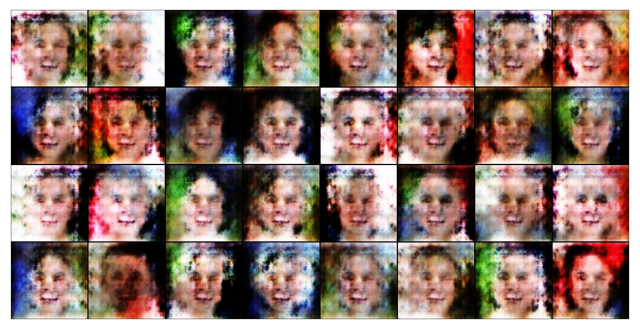

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [30/50], loss_g: 4.5322, loss_d: 0.5824, real_score: 0.8176, fake_score: 0.1815


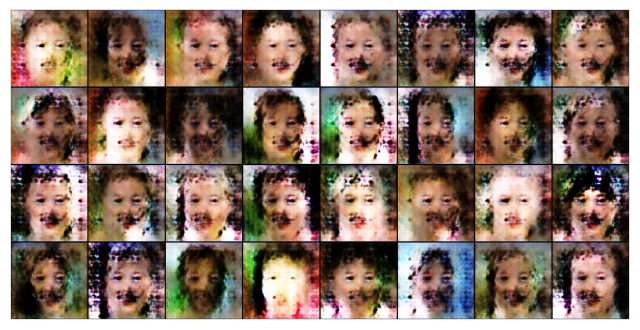

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [31/50], loss_g: 4.5096, loss_d: 0.5427, real_score: 0.8212, fake_score: 0.1769


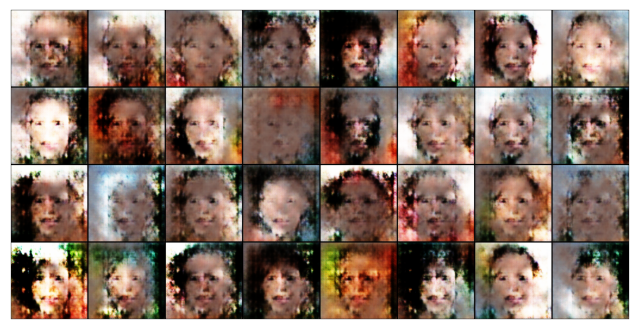

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [32/50], loss_g: 4.4821, loss_d: 0.5687, real_score: 0.8196, fake_score: 0.1772


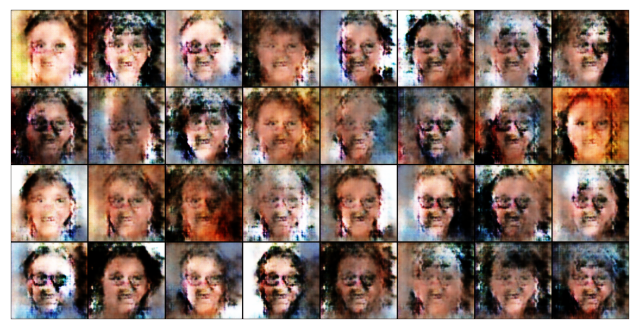

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [33/50], loss_g: 4.7665, loss_d: 0.6040, real_score: 0.8138, fake_score: 0.1802


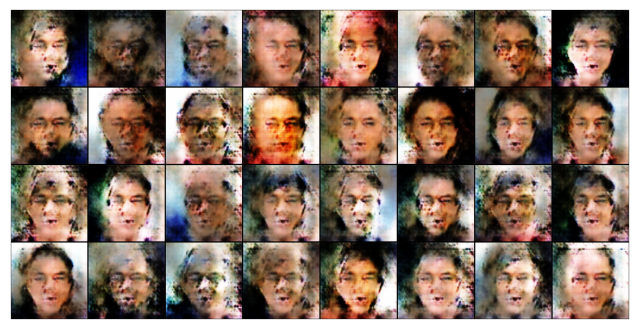

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [34/50], loss_g: 4.3358, loss_d: 0.5715, real_score: 0.8158, fake_score: 0.1911


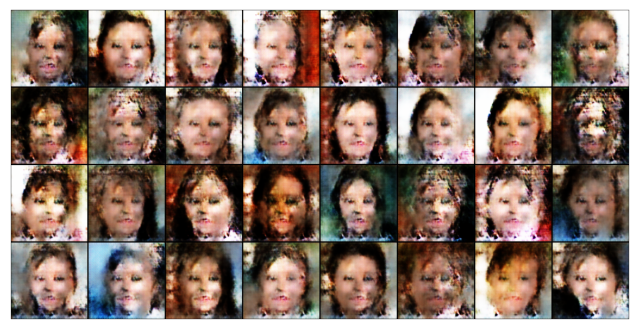

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [35/50], loss_g: 4.7496, loss_d: 0.5563, real_score: 0.8168, fake_score: 0.1754


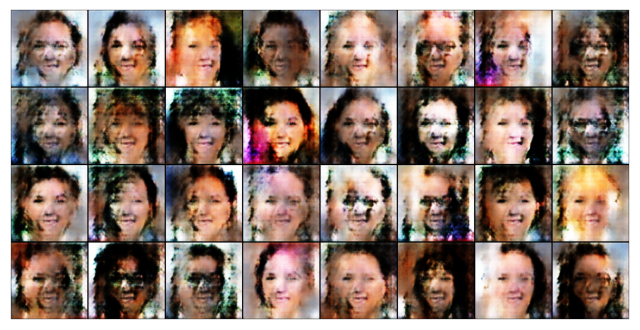

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [36/50], loss_g: 4.5200, loss_d: 0.5546, real_score: 0.8262, fake_score: 0.1734


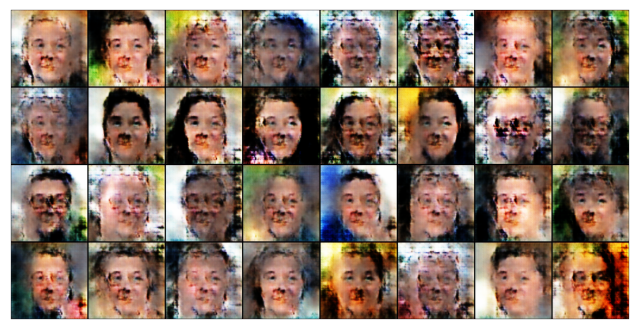

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [37/50], loss_g: 4.7892, loss_d: 0.4395, real_score: 0.8444, fake_score: 0.1550


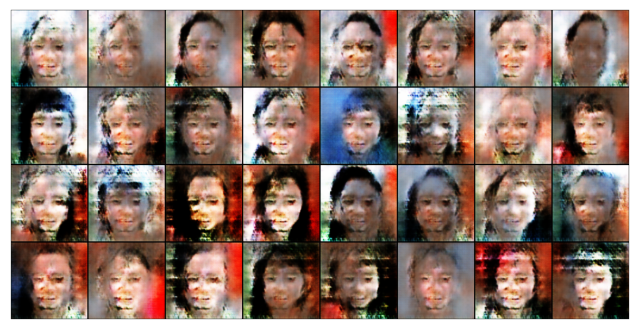

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [38/50], loss_g: 5.1146, loss_d: 0.4639, real_score: 0.8439, fake_score: 0.1522


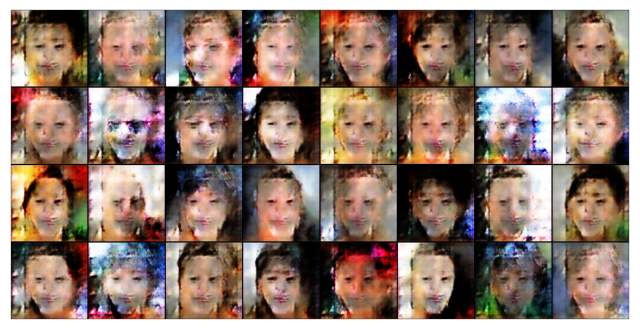

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [39/50], loss_g: 4.7122, loss_d: 0.4427, real_score: 0.8478, fake_score: 0.1483


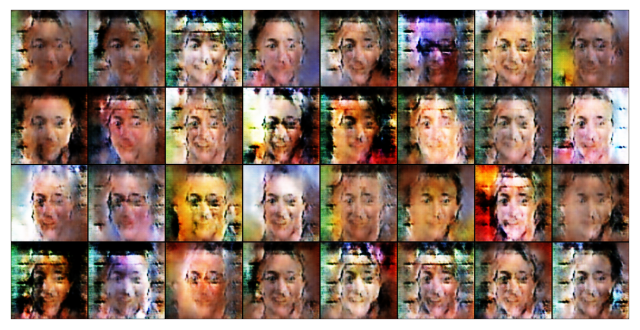

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [40/50], loss_g: 5.5003, loss_d: 0.4688, real_score: 0.8505, fake_score: 0.1482


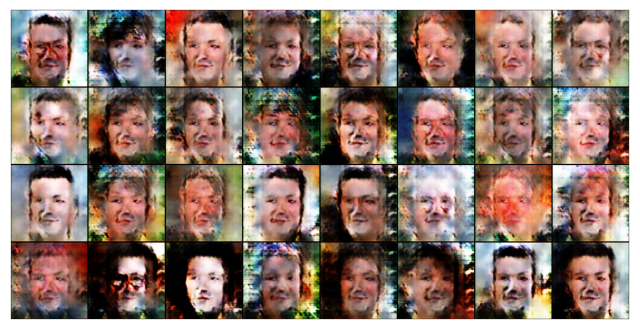

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [41/50], loss_g: 5.2784, loss_d: 0.4709, real_score: 0.8496, fake_score: 0.1445


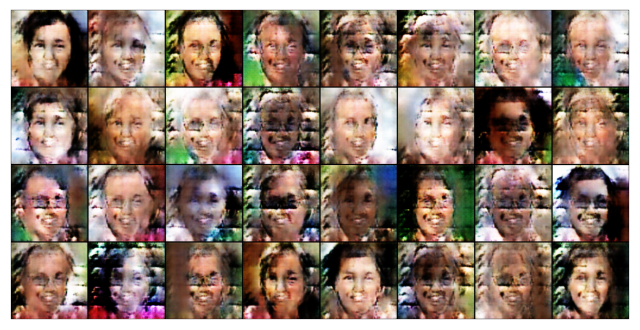

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [42/50], loss_g: 5.2333, loss_d: 0.4362, real_score: 0.8578, fake_score: 0.1432


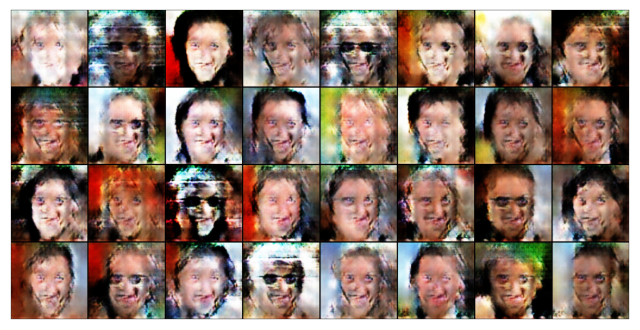

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [43/50], loss_g: 5.3411, loss_d: 0.3896, real_score: 0.8669, fake_score: 0.1338


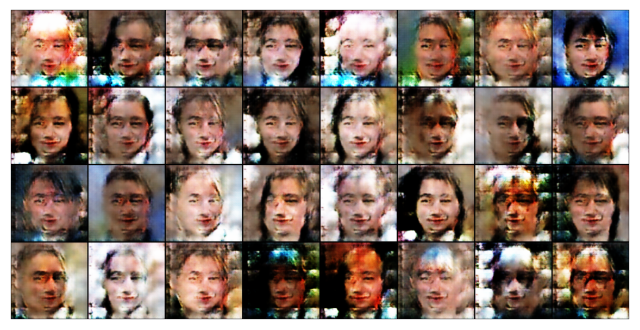

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [44/50], loss_g: 5.0395, loss_d: 0.3034, real_score: 0.8840, fake_score: 0.1094


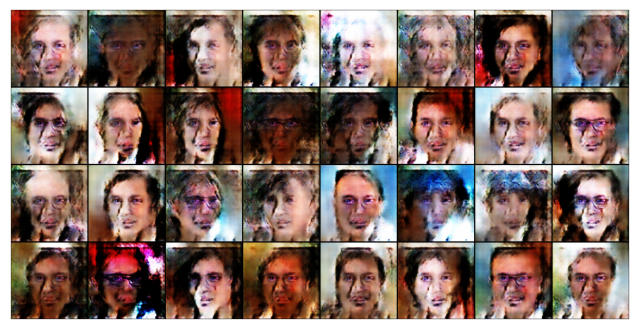

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [45/50], loss_g: 5.6920, loss_d: 0.4567, real_score: 0.8582, fake_score: 0.1441


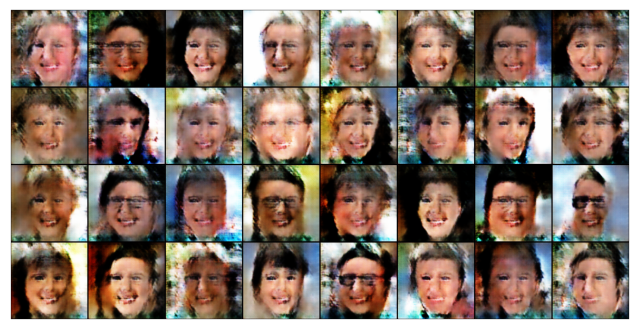

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [46/50], loss_g: 5.2269, loss_d: 0.3384, real_score: 0.8773, fake_score: 0.1164


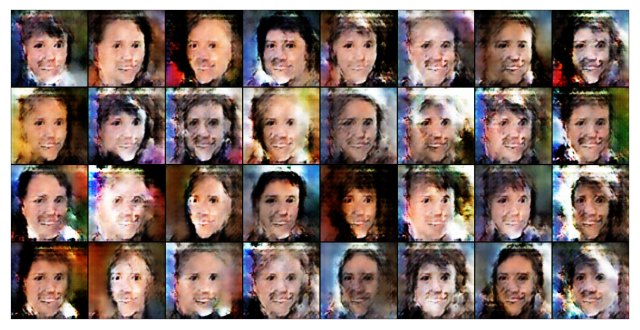

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [47/50], loss_g: 5.9211, loss_d: 0.4163, real_score: 0.8677, fake_score: 0.1322


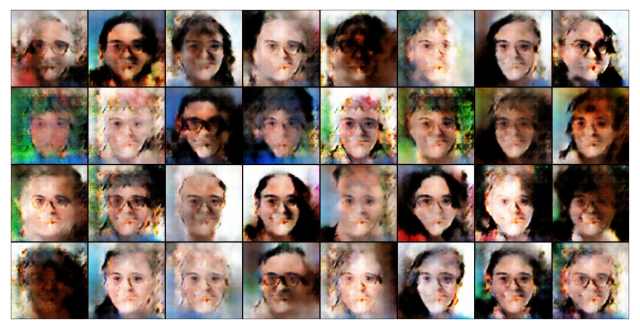

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [48/50], loss_g: 5.4545, loss_d: 0.3338, real_score: 0.8862, fake_score: 0.1206


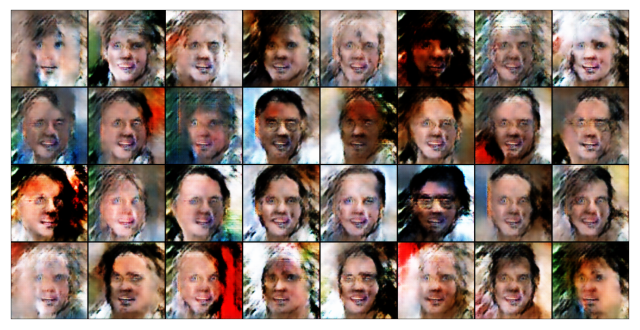

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [49/50], loss_g: 5.4687, loss_d: 0.3487, real_score: 0.8781, fake_score: 0.1165


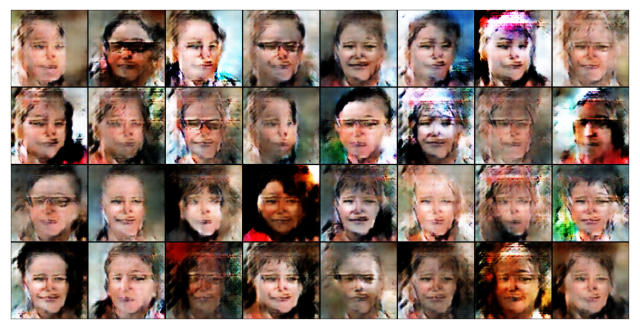

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch [50/50], loss_g: 5.6082, loss_d: 0.3642, real_score: 0.8766, fake_score: 0.1207


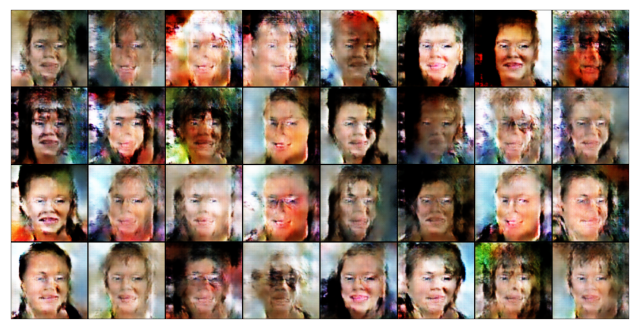

In [52]:
losses_g, losses_d, real_scores, fake_scores = fit(model, criterion, 50, lr)

Постройте графики лосса для генератора и дискриминатора. Что вы можете сказать про эти графики?

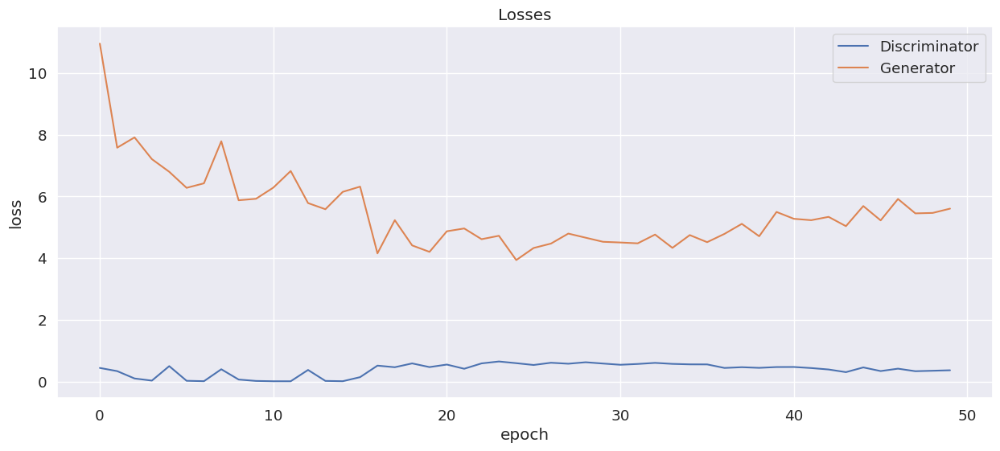

In [53]:
plt.figure(figsize=(15, 6))
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

In [54]:
torch.save(model['generator'].state_dict(), "/kaggle/working/generator")
torch.save(model['discriminator'].state_dict(), "/kaggle/working/discriminator")

## Часть 3. Генерация изображений (1 балл)

Теперь давайте оценим качество получившихся изображений. Напишите функцию, которая выводит изображения, сгенерированные нашим генератором

In [55]:
n_images = 4

fixed_latent = torch.randn(n_images, latent_size, 1, 1, device=DEVICE)
fake_images = model["generator"](fixed_latent)

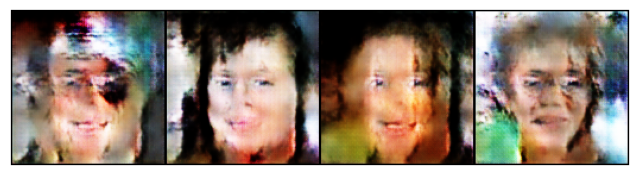

In [56]:
show_images(fake_images.cpu())

Как вам качество получившихся изображений?

:))))))) Страшновато

## Часть 4. Leave-one-out-1-NN classifier accuracy (6 баллов)

### 4.1. Подсчет accuracy (4 балла)

Не всегда бывает удобно оценивать качество сгенерированных картинок глазами. В качестве альтернативы вам предлагается реализовать следующий подход:
  * Сгенерировать столько же фейковых изображений, сколько есть настоящих в обучающей выборке. Присвоить фейковым метку класса 0, настоящим – 1.
  * Построить leave-one-out оценку: обучить 1NN Classifier (`sklearn.neighbors.KNeighborsClassifier(n_neighbors=1)`) предсказывать класс на всех объектах, кроме одного, проверить качество (accuracy) на оставшемся объекте. В этом вам поможет `sklearn.model_selection.LeaveOneOut`

In [57]:
discriminator.load_state_dict(torch.load("/kaggle/input/model1/discriminator"))
generator.load_state_dict(torch.load("/kaggle/input/model1/generator"))

model = {
    "discriminator": discriminator.to(DEVICE),
    "generator": generator.to(DEVICE)
}

In [58]:
import numpy as np
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import LeaveOneOut

train_loader = get_dataloader(image_size, 1)
X_data = []

for i, (X_batch, _) in enumerate(train_loader):  # Предполагаем, что метки для DataLoader не используются
    X_data.append(X_batch.squeeze(0).numpy())
    if i == 100:
        break

X_data = np.array(X_data)
X_data = X_data.reshape(-1, 3*128*128)

In [59]:
fixed_latent = torch.randn(len(X_data), latent_size, 1, 1, device = DEVICE)
fake_images = model["generator"](fixed_latent)

X_data = np.vstack((X_data, fake_images.cpu().detach().numpy().reshape(-1, 3*128*128)))

In [60]:
X_data.shape

(202, 49152)

In [61]:
y_labels = np.ones(len(X_data)//2, dtype = np.float64)
y_labels_fake = np.zeros(len(X_data)//2, dtype = np.float64)
y_labels = np.vstack((y_labels, y_labels_fake))
y_labels = y_labels.reshape(len(X_data))

In [62]:
knn_classifier = KNeighborsClassifier(n_neighbors=1)

leave_one_out = LeaveOneOut()

accuracies = []
for train_index, test_index in leave_one_out.split(X_data):
    knn_classifier.fit(X_data[train_index], y_labels[train_index])

    accuracy = knn_classifier.score(X_data[train_index], y_labels[train_index])
    accuracies.append(accuracy)

mean_accuracy = np.mean(accuracies)

print(f"Средняя точность на leave-one-out оценке: {mean_accuracy}")

Средняя точность на leave-one-out оценке: 1.0


Что вы можете сказать о получившемся результате? Какой accuracy мы хотели бы получить и почему?

Скорее всего идеальным результатом при оценке точности на leave-one-out было бы 0.5

### 4.2. Визуализация распределений (2 балла)

Давайте посмотрим на то, насколько похожи распределения настоящих и фейковых изображений. Для этого воспользуйтесь методом, снижающим размерность (к примеру, TSNE) и изобразите на графике разным цветом точки, соответствующие реальным и сгенерированным изображенияи

In [63]:
from sklearn.manifold import TSNE

X_embedded = TSNE(n_components=2).fit_transform(X_data)

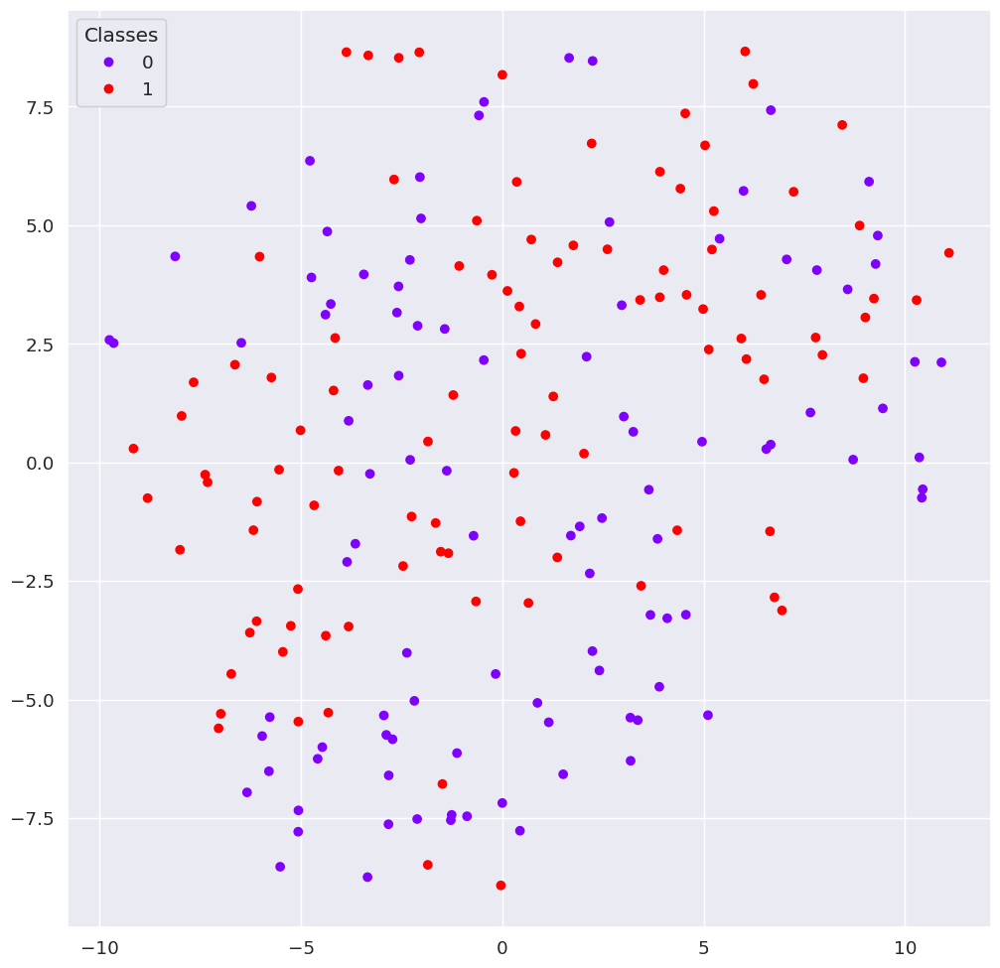

In [64]:
fig, ax = plt.subplots(figsize = (12, 12))

scatter = ax.scatter(X_embedded[:, 0], X_embedded[:, 1], c=y_labels, cmap=plt.cm.rainbow)

legend1 = ax.legend(*scatter.legend_elements(),
                    loc="upper left", title="Classes")
ax.add_artist(legend1)

Прокомментируйте получившийся результат:

Видно как истинные изображения распределены не так как сгенерированные, но очень близко к этому